# Finetune Self-Supervision

- Finetune the deep network after pretraining the self-supervised learning framework.

-----

## Load Packages

In [1]:
# for auto-reloading external modules
# see http://stackoverflow.com/questions/1907993/autoreload-of-modules-in-ipython
%load_ext autoreload
%autoreload 2
%cd ..

D:\GitHub\eeg_analysis


In [52]:
# Load some packages
import os
import gc
from copy import deepcopy
import hydra
from omegaconf import OmegaConf
import wandb
import pprint
import numpy as np
import torch
from tqdm.auto import tqdm

import matplotlib
import matplotlib.pyplot as plt
import scienceplots

# custom package
from run_train import check_device_env
from run_train import set_seed
from run_train import compose_dataset
from run_train import generate_model
from train.train_script import train_script
from models.utils import count_parameters

In [2]:
# Other settings
%matplotlib inline
%config InlineBackend.figure_format = 'retina' # cleaner text

plt.style.use('default') 
# ['Solarize_Light2', '_classic_test_patch', 'bmh', 'classic', 'dark_background', 'fast', 
#  'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn', 'seaborn-bright', 'seaborn-colorblind', 
#  'seaborn-dark', 'seaborn-dark-palette', 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 
#  'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 
#  'seaborn-ticks', 'seaborn-white', 'seaborn-whitegrid', 'tableau-colorblind10']

plt.rcParams['image.interpolation'] = 'bicubic'
plt.rcParams["font.family"] = 'Roboto Slab' # 'NanumGothic' # for Hangul in Windows
plt.style.use('classic') 
plt.style.use('default') 
plt.style.use('default') # default, ggplot, fivethirtyeight, bmh, dark_background, classic
plt.rcParams.update({'font.size': 14})
plt.rcParams.update({'font.family': 'Roboto Slab'})
plt.rcParams["savefig.dpi"] = 1200

---

## Specify the dataset, model, and train setting

In [3]:
pre_model_path = 'local/checkpoint/'
pre_model_name = '2ew55ua4'
target_datasets = ['train', 'val']

use_wandb = True
device = 'cuda:0'

In [4]:
print('PyTorch version:', torch.__version__)
device = torch.device(device if torch.cuda.is_available() else 'cpu')

if torch.cuda.is_available(): print('cuda is available.')
else: print('cuda is unavailable.')

PyTorch version: 2.0.0+cu117
cuda is available.


---

## Load and modify the pretrained network

In [5]:
# load pretrained configurations
path = os.path.join(pre_model_path, pre_model_name.split(',')[-1], 'checkpoint.pt')
try:
    ckpt = torch.load(path, map_location=device)
    config = ckpt['config']
except Exception as e:
    print(e)
    print(f'- checkpoint cannot be opened: {path}')

# initiate the model
model = generate_model(config).to(device)
model.requires_grad_(False)
model.eval()
pprint.pprint(config)

{'EKG': 'X',
 '_target_': 'models.ssl.mae.mae_pre_b_e768_d512',
 'activation': 'gelu',
 'age_mean': tensor([71.1417], device='cuda:0'),
 'age_std': tensor([9.7264], device='cuda:0'),
 'awgn': 0.01,
 'awgn_age': 0.001,
 'base_lr': 0.00012226453861270155,
 'class_label_to_name': ['Normal', 'MCI', 'Dementia'],
 'class_name_to_label': {'Dementia': 2, 'MCI': 1, 'Normal': 0},
 'criterion': 'cross-entropy',
 'crop_length': 4096,
 'crop_multiple': 4,
 'crop_timing_analysis': False,
 'cwd': 'D:\\GitHub\\eeg_analysis',
 'dataset_name': 'CAUEEG dataset',
 'dataset_path': 'local/dataset/caueeg-dataset/',
 'ddp': False,
 'device': device(type='cuda'),
 'draw_result': True,
 'file_format': 'memmap',
 'in_channels': 19,
 'input_norm': 'datapoint',
 'iterations': 390625,
 'latency': 2000,
 'load_event': False,
 'lr_scheduler_type': 'cosine_decay_with_warmup_half',
 'mask_ratio': 0.5,
 'mgn': 0.01,
 'minibatch': 256,
 'minibatch_3090': 256,
 'mixup': 0.0,
 'multi_batch_size': 32,
 'norm_pix_loss': Fals

In [34]:
train_loader, val_loader, test_loader, _ = compose_dataset(config)


signal_header = [channel.split('-')[0] for i, channel in enumerate(config["signal_header"])]

---
## Visualize

In [62]:
@plt.style.context(['ieee', 'science', 'default'])
def draw_eeg_graph(x, pred, mask):
    N, C, L = x.shape
    _, l = mask.shape
    patch_size = L // l

    for n in range(N):
        fig = plt.figure(num=1, clear=True, figsize=(25.0, 15.0))
        fig.subplots_adjust(hspace=0)
        
        for c in range(C):
            ax = fig.add_subplot(C, 1, c + 1)
            ax.plot(x[n, c].cpu().numpy(), lw=1, c='black', label='origin')
            ax.plot(pred[n, c].cpu().numpy(), lw=1, c='blue', label='pred')

            for r in range(l):
                if mask[n, r]:
                    ax.axvspan(r*patch_size, (r + 1)*patch_size, facecolor='purple', alpha=0.2)

            ax.set_xlim(0, L)
            ax.set_ylabel(signal_header[c])
            ax.set_xticks(np.arange(round(config["seq_length"] / 200) + 1) * 200)
            ax.set_xticklabels([])
            # ax.tick_params(axis='x', width=0.1, length=0.1)
            ax.set_yticks([0])
            ax.set_yticklabels([])
        
        ax.set_xticks(np.arange(round(config["seq_length"] / 200) + 1) * 200)
        ax.set_xticklabels(np.arange(round(config["seq_length"] / 200) + 1))
        
        ax.set_xlabel('Time (s)')
        # fig.savefig(os.path.join(output_folder, 'signal_example.pdf'), transparent=True)
        plt.show()
        fig.clear()
        plt.close(fig)

Dataset:   0%|          | 0/2 [00:00<?, ?it/s]

Batch:   0%|          | 0/14 [00:00<?, ?it/s]

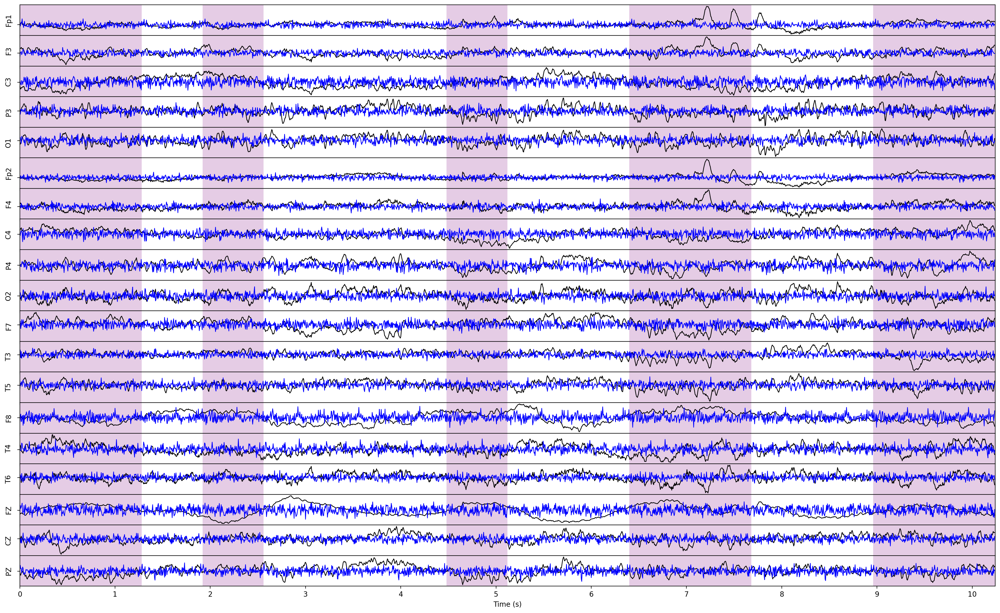

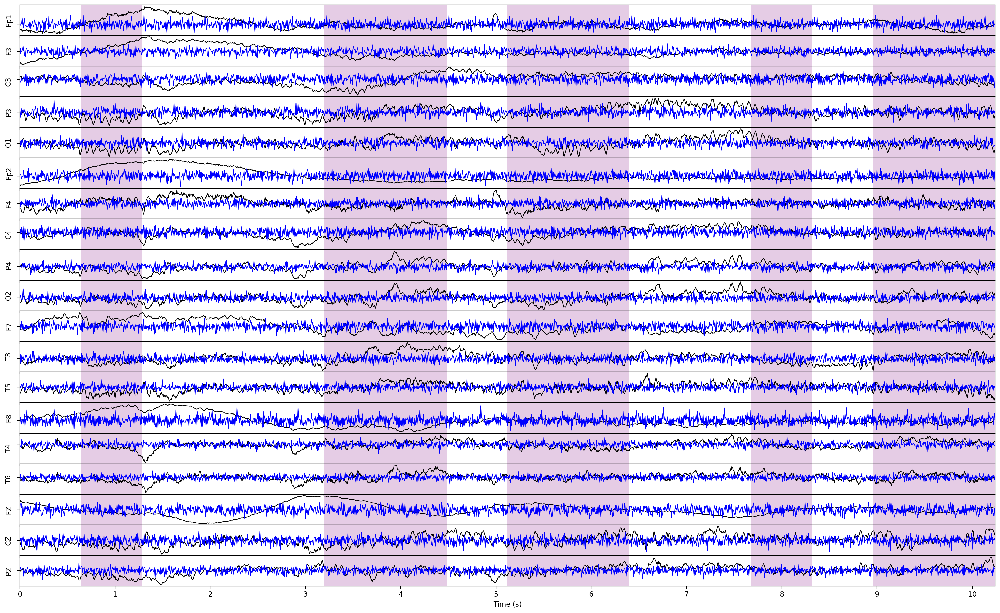

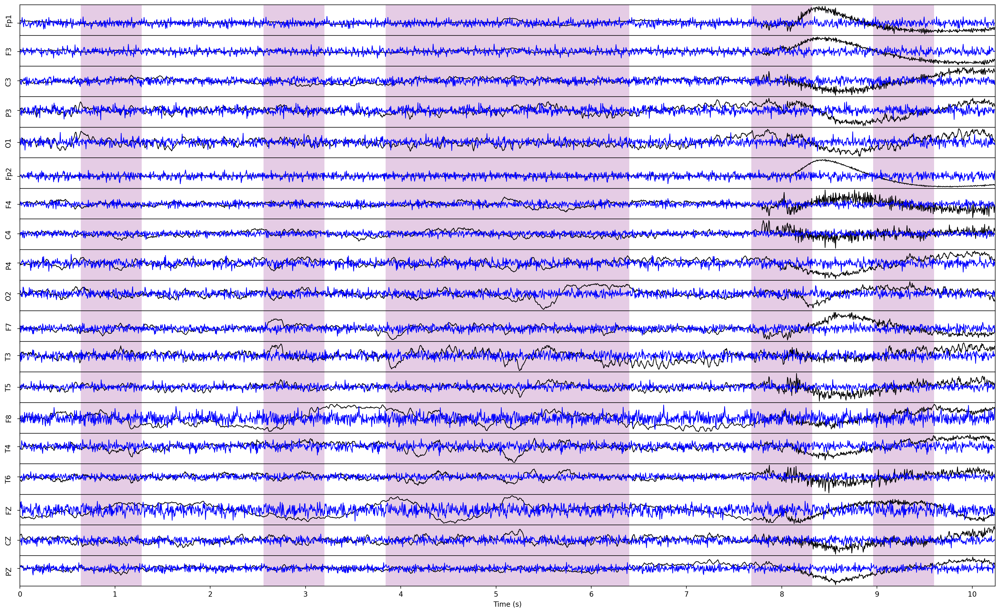

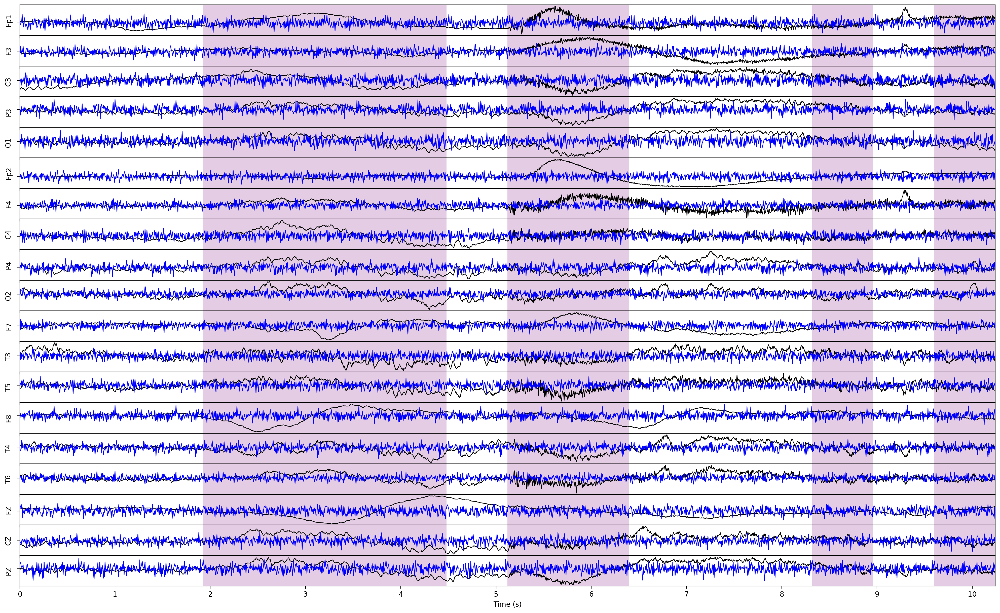

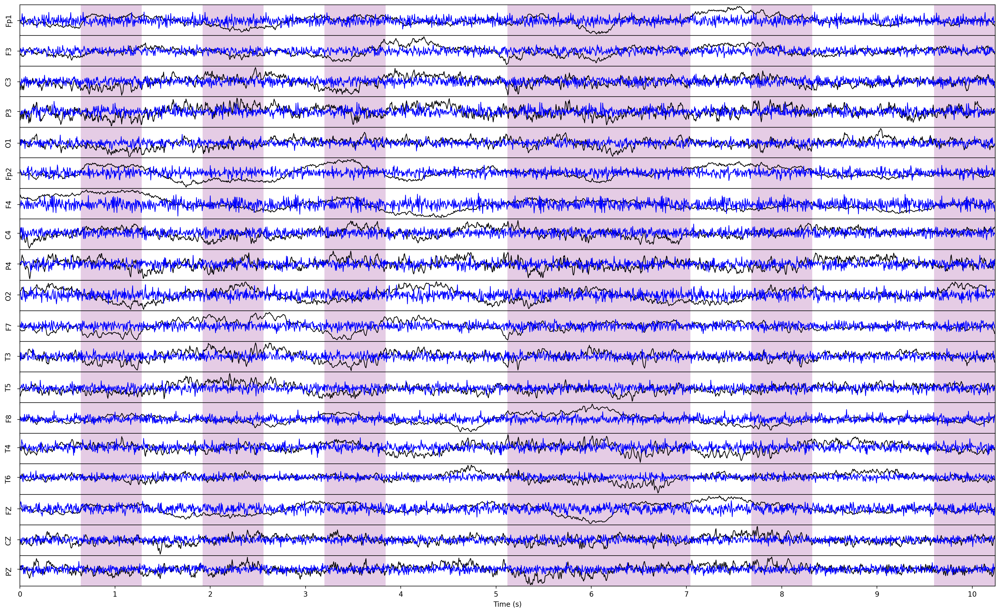

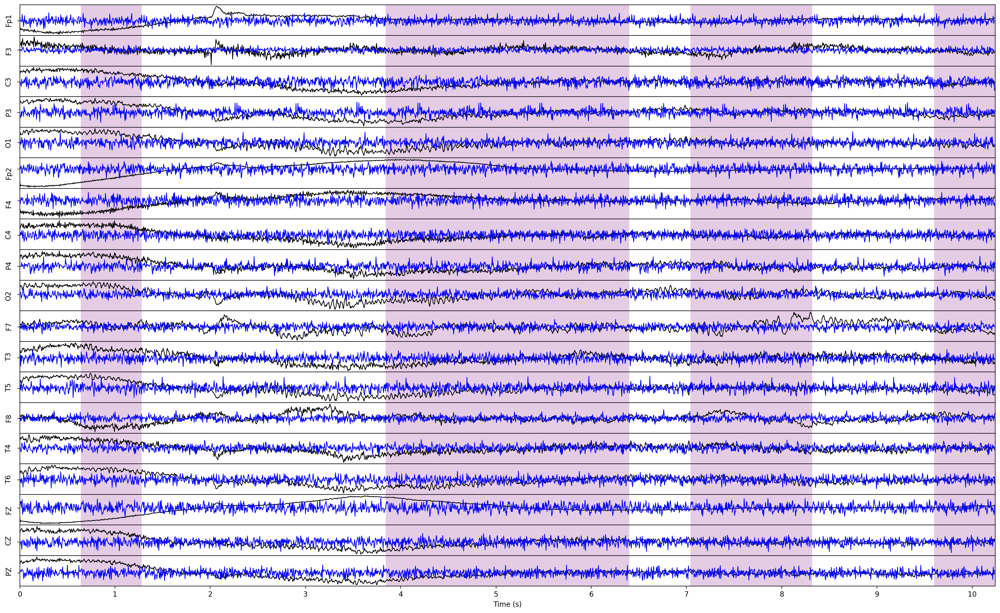

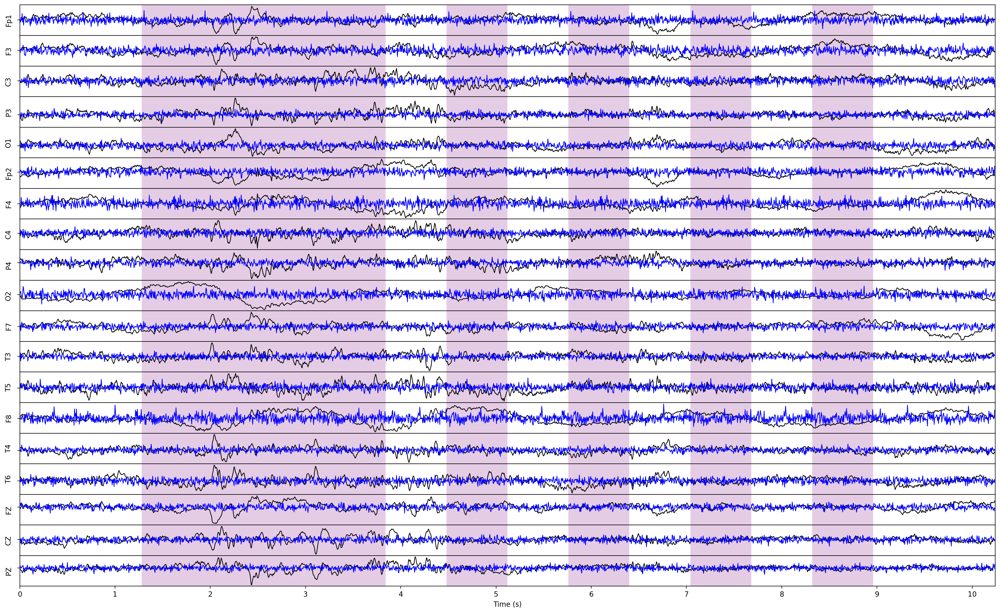

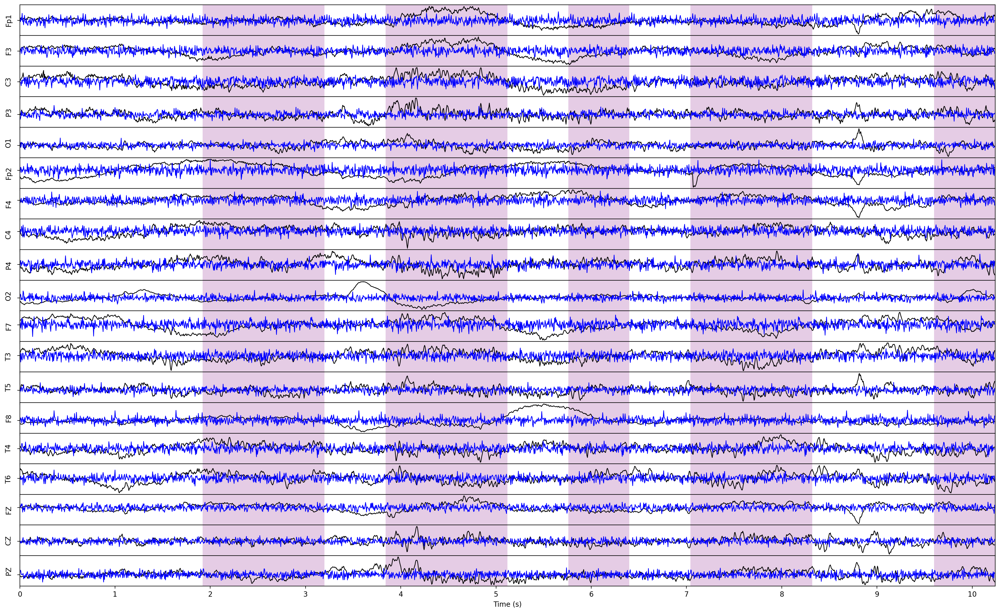

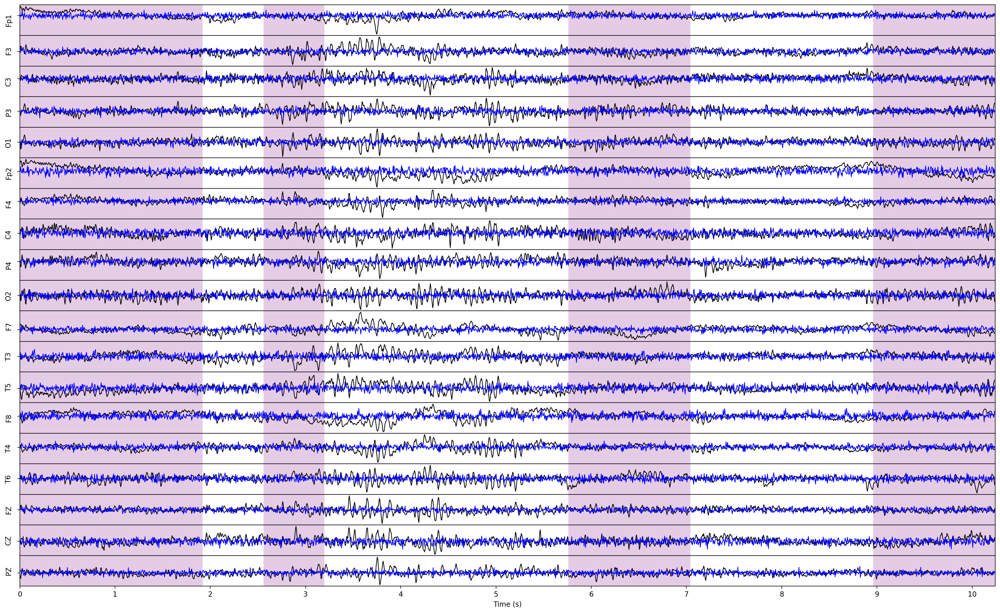

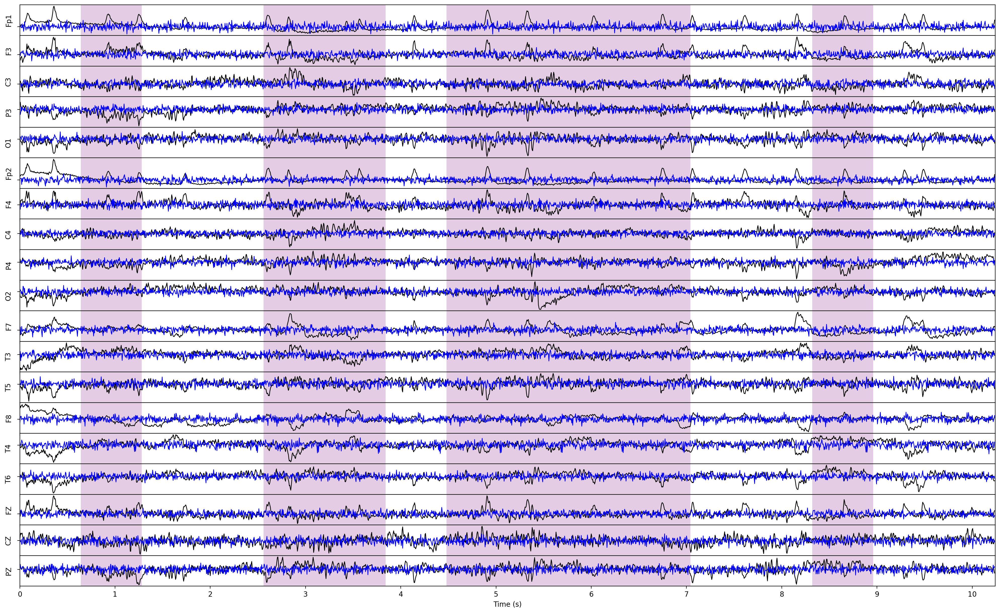

In [ ]:
with torch.no_grad():
    for target_dataset in tqdm(target_datasets, desc="Dataset", leave=False):
        if target_dataset == 'train':
            loader = train_loader
        elif target_dataset == 'val':
            loader = val_loader
        elif target_dataset == 'test':
            loader = test_loader
        else:
            raise ValueError('')
                
        for sample_batched in tqdm(loader, total=len(loader), desc='Batch', leave=False):
            config["preprocess_test"](sample_batched)
            x = sample_batched["signal"]
            age = sample_batched["age"]

            loss, pred, mask = model(x, age, config["mask_ratio"])
            pred_eeg = model.unpatchify(pred)

            draw_eeg_graph(x, pred_eeg, mask)

            break
        break